# <center> <u> Regression analysis </u> </center>

**Regression analysis is a statistical method that shows the relationship between two or more variables. Usually expressed in a graph, the method tests the relationship between a dependent variable against independent variables**

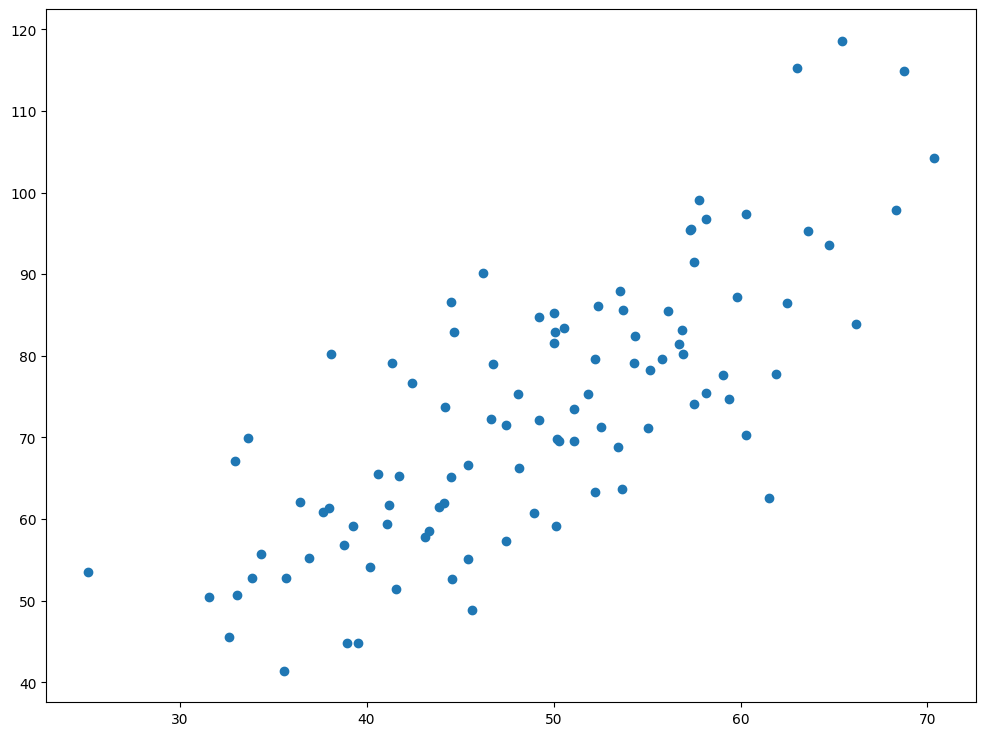

In [8]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12.0, 9.0) # plot figure

# Preprocessing Input data
data = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Mumbai_house.csv')
X = data.iloc[:, 0]
Y = data.iloc[:, 1] 
plt.scatter(X, Y)
plt.show()

1.4796491688889395 0.10148121494753734


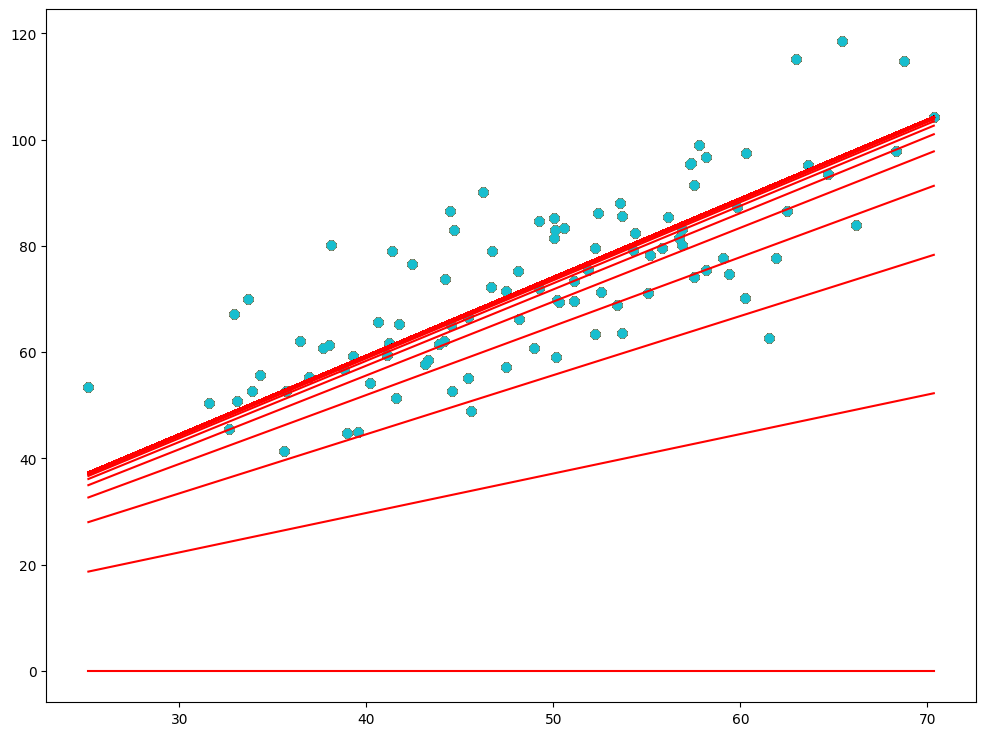

In [9]:
m = 0
c = 0

L = 0.0001  # The learning Rate
epochs = 1000  # The number of iterations to perform gradient descent

n = float(len(X)) # Number of elements in X

# Performing Gradient Descent 
for i in range(epochs): 
    Y_pred = m*X + c  # The current predicted value of Y
    D_m = (-2/n) * sum(X * (Y - Y_pred))  # Derivative wrt m
    D_c = (-2/n) * sum(Y - Y_pred)  # Derivative wrt c
    m = m - L * D_m  # Update m
    c = c - L * D_c  # Update c
    plt.scatter(X, Y)
    plt.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='red')
print (m, c)

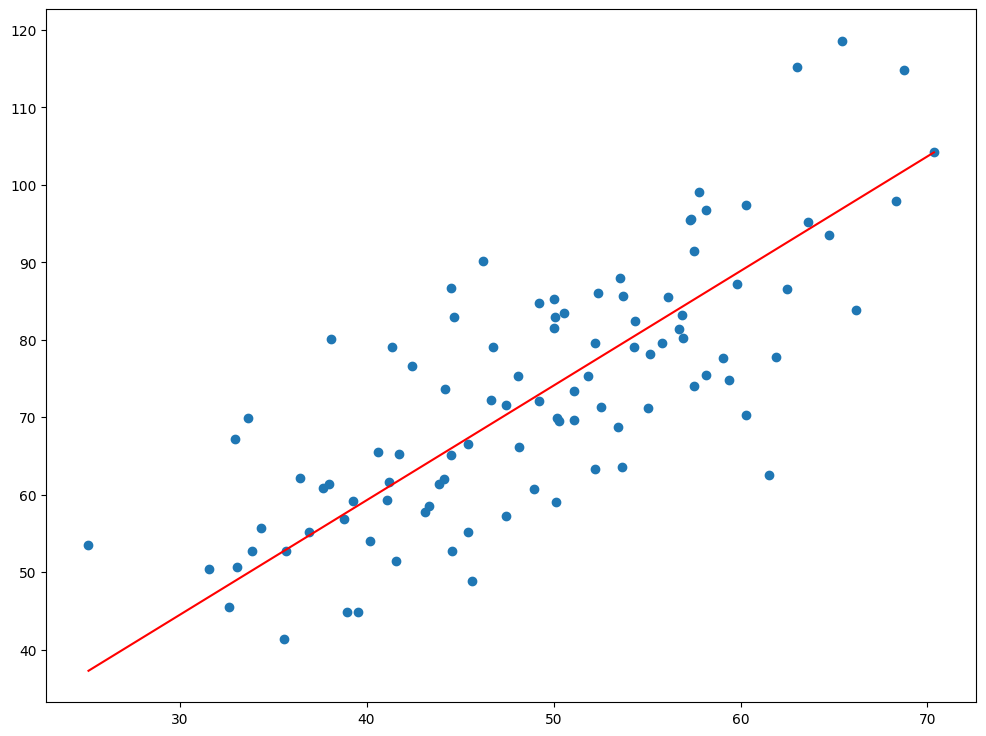

Predicted value : 
0     79.154407
1     91.144824
2     70.348772
3     88.604045
4     81.692574
        ...    
94    74.128587
95    72.959059
96    74.142498
97    71.346380
98    37.282823
Name: 32.502345269453031, Length: 99, dtype: float64


In [10]:
# Making predictions
Y_pred = m*X + c

plt.scatter(X, Y)
plt.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='red') # predicted
plt.show()

print('Predicted value : ')
print(Y_pred)

In [11]:
#! pip3 install ffmpeg-python

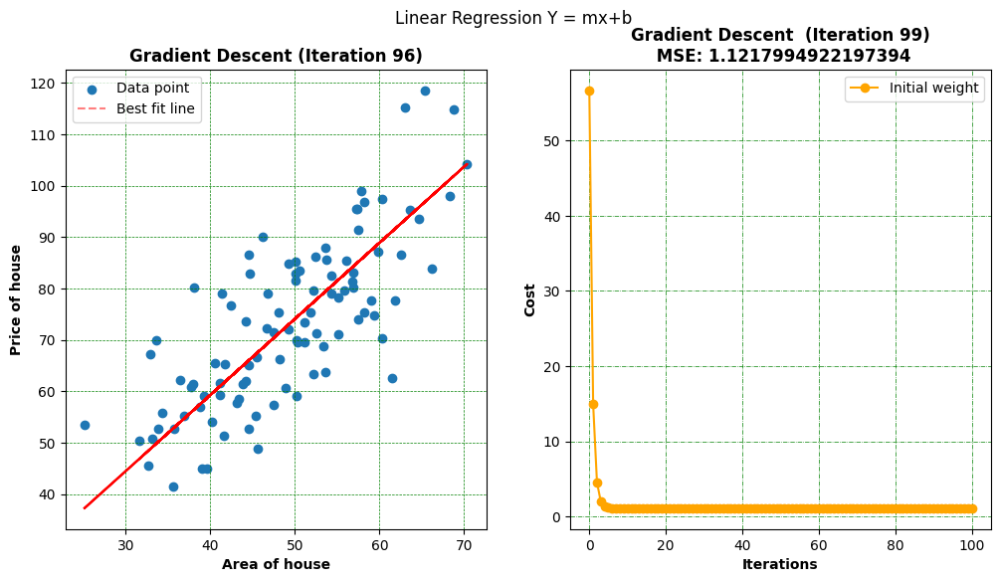

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error
from matplotlib.animation import FuncAnimation
from IPython.display import display, HTML

def Gradient_descent():
    plt.rcParams['figure.figsize'] = (12.0, 6.0)  # Adjust plot size
    
    # Preprocessing Input data
    data = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Mumbai_house.csv')
    X = data.iloc[:, 0]
    Y = data.iloc[:, 1]

    m = 0 #slope
    c = 0 #intercept
    L = 0.0001  # The learning Rate or Alpha | The learning rate L determines the step size of each update. 
    epochs = 100  # The number of iterations to perform gradient descent
    n = float(len(X))  # Number of elements in X 

    fig, axs = plt.subplots(1, 2)
    fig.suptitle('Linear Regression Y = mx+b')
    axs[0].set_title('Linear Relationship', weight='bold')
    axs[0].grid()
    axs[0].scatter(X, Y)

    cost_history = []

    def animate(i):
        nonlocal m, c
        Y_pred = m * X + c
        D_m = (-2/n) * sum(X * (Y - Y_pred))
        D_c = (-2/n) * sum(Y - Y_pred)
        m -= L * D_m
        c -= L * D_c

        cost = np.mean(np.square(Y - Y_pred))/X.shape[0]
        cost_history.append(cost)

        axs[1].clear()
        axs[1].set_title(f'Gradient Descent  (Iteration {i})\n MSE: {cost}', weight='bold')
        axs[1].plot(range(len(cost_history)), cost_history, marker='o', color="orange", label='Initial weight')
        axs[1].set_xlabel('Iterations', weight='bold')
        axs[1].set_ylabel('Cost', weight='bold')
        axs[1].grid(color='green', linestyle='-.', linewidth=0.5)
        axs[1].legend()
        axs[0].plot(X, Y_pred, color='red')

        if i % 4 == 0:
            axs[0].clear()
            axs[0].set_title(f'Gradient Descent (Iteration {i})', weight='bold')
            axs[0].grid(color='green', linestyle='--', linewidth=0.5)
            axs[0].scatter(X, Y, label='Data point')
            best_fit_x = np.array([min(X), max(X)])
            best_fit_y = m * best_fit_x + c
            axs[0].plot(best_fit_x, best_fit_y, color='red', alpha=0.5, label='Best fit line', linestyle="--")
            axs[0].set_ylabel('Price of house', weight='bold')
            axs[0].set_xlabel('Area of house', weight='bold')
            axs[0].legend()


    anim = FuncAnimation(fig, animate, frames=epochs, repeat=False)
    display(HTML(anim.to_jshtml()))

if __name__ == "__main__":
    Gradient_descent()


# 3D Visulization of Gradient descent

In [13]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 50.0
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


def Gradient_descent():
    plt.rcParams['figure.figsize'] = (12.0, 6.0)  # Adjust plot size
    
    # Preprocessing Input data
    data = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Mumbai_house.csv')
    X = data.iloc[:, 0]
    Y = data.iloc[:, 1]

    m = 0  # slope
    c = 0  # intercept
    L = 0.0001  # The learning Rate or Alpha
    epochs = 100  # The number of iterations to perform gradient descent
    n = float(len(X))  # Number of elements in X 

    fig = plt.figure()
    fig.suptitle('Linear Regression Y = mx+b')

    axs = fig.add_subplot(121, projection='3d')
    bxs = fig.add_subplot(122, projection='3d')

    def compute_cost(m, c):
        Y_pred = m * X + c
        cost = np.mean(np.square(Y - Y_pred)) / X.shape[0]
        return cost

    cost_history = []
    m_history = []
    c_history = []

    def update(frame):
        nonlocal m, c

        Y_pred = m * X + c
        D_m = (-2/n) * sum(X * (Y - Y_pred))
        D_c = (-2/n) * sum(Y - Y_pred)
        m -= L * D_m
        c -= L * D_c

        current_cost = compute_cost(m, c)
        cost_history.append(current_cost)
        m_history.append(m)
        c_history.append(c)

        axs.clear()
        axs.set_xlabel('Slope (m)', weight='bold')
        axs.set_ylabel('Intercept (c)', weight='bold')
        axs.set_zlabel('Cost', weight='bold')
        axs.set_title(f'Gradient Descent (Iteration {frame})\n Error is {current_cost}', weight='bold')
        axs.plot(m_history, c_history, cost_history, marker='o', color='blue', label='Optimization Path')

        bxs.clear()
        bxs.set_title(f'Gradient Descent (Iteration {frame})', weight='bold')
        bxs.grid(color='green', linestyle='--', linewidth=0.5)
        bxs.scatter(X, Y, label='Data point')
        bxs.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='red', alpha=0.5, label='Best fit line', linestyle="--")
        bxs.set_ylabel('Price of house', weight='bold')
        bxs.set_xlabel('Area of house', weight='bold')
        bxs.set_zlabel('Predicted Path', weight='bold')
        bxs.legend()

    anim = FuncAnimation(fig, update, frames=epochs, repeat=False)
    plt.close()
    
    return anim

if __name__ == '__main__':
    animation = Gradient_descent()
    display(HTML(animation.to_jshtml()))


axs[1, 0].stem(range(len(rmse_history)), rmse_history, marker='o', color="orange",label='Initial weight')


This code is an implementation of gradient descent for linear regression using Python. It uses the pandas library for data manipulation, numpy for numerical operations, matplotlib for creating plots and animations, and scikit-learn's mean squared error (MSE) and mean absolute error (MAE) functions for evaluating the regression model's performance.

Here's a step-by-step explanation of the code:

1. Importing Libraries:
   - The code begins by importing necessary libraries: pandas, numpy, matplotlib.pyplot, and relevant functions/classes from sklearn and other modules.

2. `Gradient_descent()` Function:
   - This function implements gradient descent to perform linear regression.
   - It adjusts the slope (m) and intercept (c) of the linear equation `Y = mx + c` to fit the data.
   - The learning rate (`L`) determines the step size of each parameter update.
   - The number of iterations (`epochs`) specifies how many iterations gradient descent should perform.

3. Preprocessing Input Data:
   - The code reads a CSV file named 'Mumbai_house.csv' using pandas and extracts the input features (X) and target values (Y) from the data.

4. Initializing Parameters:
   - `m` and `c` are initialized to 0, representing the initial slope and intercept of the linear equation.
   - `L` is the learning rate.
   - `epochs` is the number of iterations.
   - `n` stores the number of data points.

5. Creating Plot:
   - The code creates a plot using matplotlib, setting up two subplots side by side.
   - The first subplot shows the scatter plot of the data points (X vs. Y).
   - The second subplot will later display the cost history and the regression line's progress.

6. Gradient Descent Loop:
   - The `animate` function performs the gradient descent iterations.
   - In each iteration:
     - Predicted values `Y_pred` are calculated using the current `m` and `c`.
     - Partial derivatives with respect to `m` (D_m) and `c` (D_c) are calculated.
     - `m` and `c` are updated based on the derivatives and the learning rate.
     - The mean squared error (MSE) cost is calculated and appended to the `cost_history` list.
     - The second subplot is updated to show the cost history plot and the evolving regression line.

7. Animation:
   - The `FuncAnimation` class from matplotlib is used to animate the gradient descent process.
   - The `animate` function is called for each frame (iteration) of the animation.
   - The `HTML(anim.to_jshtml())` line generates and displays the animation in the Jupyter Notebook environment.

8. Main Block:
   - The `if __name__ == "__main__":` block ensures that the `Gradient_descent()` function is executed only when the script is run as the main program.

9. Summary:
   - The code visualizes how the linear regression model's parameters (slope and intercept) are updated over multiple iterations to fit the data using gradient descent.
   - The animation shows the changing regression line and the cost history plot.

Note: The code assumes that a CSV file named 'Mumbai_house.csv' is available at the specified file path. Additionally, the script is intended to be run in a Jupyter Notebook environment due to the use of `display(HTML(anim.to_jshtml()))` for animation rendering.

In [14]:
import pandas as pd
df = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Ice_cream selling data.csv')
df.head(5)

,Temperature (°C),Ice Cream Sales (units)
0,-4.662263,41.842986
1,-4.316559,34.661120
2,-4.213985,39.383001
3,-3.949661,37.539845
4,-3.578554,32.284531
